compare different methods to find the best accuracy for predictions

In [89]:
import os
from glob import glob
from pathlib import Path
import librosa
import IPython.display as ipd
import librosa.display
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd
import numpy as np

In [62]:
folder= "train\positive\scream"
wavs_folder= Path(folder)
max_len=0
wave_file_paths = wavs_folder.glob('*.wav')  # <class 'generator'>
bad_paths=[]
for wav_path in sorted(wave_file_paths):
    try:
        curr_len= int(librosa.get_duration(filename=wav_path))
        if max_len < curr_len:
            max_path= wav_path
            max_len= curr_len
        
    except:
        bad_paths.append(wav_path)

    break
print(bad_paths)
    #print("wav_path {} {}".format(max_len, folder))
    

[]


In [63]:
max_len

8

In [56]:
#print(len(bad_paths))
for bad in bad_paths:
    ipd.Audio(bad) # load a local WAV file

In [66]:
ipd.Audio("train\positive\scream\84351__patopurific__scream-and-death.wav") # load a local WAV file

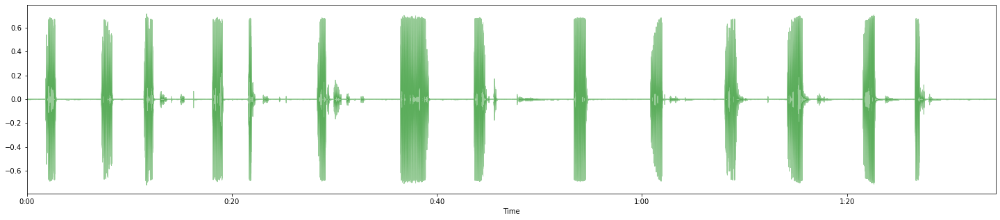

In [78]:
# verify a wav file has 14 screams in it
wav_data, sampling_rate = librosa.load("train\positive\scream\84351__patopurific__scream-and-death.wav")

plt.figure(figsize=(25,5))
librosa.display.waveplot(wav_data, sr=sampling_rate, alpha=0.4,label='scream long',color= 'green')
plt.show()

the cell below allowes for splitting a wav file according to silence.
I can use it later to run a "pass" on all my files...

In [79]:

# Define a function to normalize a chunk to a target amplitude.
def match_target_amplitude(aChunk, target_dBFS):
    ''' Normalize given audio chunk '''
    change_in_dBFS = target_dBFS - aChunk.dBFS
    return aChunk.apply_gain(change_in_dBFS)

# Load your audio.
song = AudioSegment.from_mp3("train\positive\scream\84351__patopurific__scream-and-death.wav")

# Split track where the silence is 2 seconds or more and get chunks using 
# the imported function.
chunks = split_on_silence (
    # Use the loaded audio.
    song, 
    # Specify that a silent chunk must be at least 2 seconds or 2000 ms long.
    min_silence_len = 2000,
    # Consider a chunk silent if it's quieter than -16 dBFS.
    # (You may want to adjust this parameter.)
    silence_thresh = -60
)

# Process each chunk with your parameters
for i, chunk in enumerate(chunks):
    # Create a silence chunk that's 0.5 seconds (or 500 ms) long for padding.
    silence_chunk = AudioSegment.silent(duration=500)

    # Add the padding chunk to beginning and end of the entire chunk.
    audio_chunk = silence_chunk + chunk + silence_chunk

    # Normalize the entire chunk.
    normalized_chunk = match_target_amplitude(audio_chunk, -20.0)

    # Export the audio chunk with new bitrate.
    print("Exporting chunk{0}.mp3.".format(i))
    normalized_chunk.export(
        ".//84351__patopurific__scream-and-death_chunk{0}.wav".format(i),
        bitrate = "192k",
        format = "wav"
    )

Exporting chunk0.mp3.
Exporting chunk1.mp3.
Exporting chunk2.mp3.
Exporting chunk3.mp3.
Exporting chunk4.mp3.
Exporting chunk5.mp3.
Exporting chunk6.mp3.
Exporting chunk7.mp3.
Exporting chunk8.mp3.
Exporting chunk9.mp3.
Exporting chunk10.mp3.
Exporting chunk11.mp3.
Exporting chunk12.mp3.
Exporting chunk13.mp3.


In [64]:
def findLongestWav(folder):
    """
    folder- folder to find the longest wav path
    Returns- relative path to the longest wav file
    """
    if folder==None or not os.path.exists(folder):
        print("check path ", folder)
        return None
    wavs_folder= Path(folder)
    max_len=0
    max_path=""
    wave_file_paths = wavs_folder.glob('**/*.wav')  # <class 'generator'>
    for wav_path in sorted(wave_file_paths):
        try:
            curr_len= int(librosa.get_duration(filename=wav_path))
        except:
            continue
        if max_len < curr_len:
            max_path= wav_path
            max_len= curr_len
    print("max duration: {} , path: {}".format(max_len,max_path))
    return max_path
        

In [65]:
folder= "train\positive\scream"
longest= findLongestWav(folder)

max duration: 94 , path: train\positive\scream\84351__patopurific__scream-and-death.wav


In [86]:
# mel spectogram
wav_path=Path("train\positive\scream\84351__patopurific__scream-and-death_chunk13.wav")
wav_data, sampling_rate = librosa.load(wav_path, duration=5, sr=22050)
mel_spec_long = librosa.feature.melspectrogram(y=wav_data, sr=sampling_rate)

wav_path=Path("train\positive\scream\\145802__mrbriandesign__kids-screaming-1.wav")
wav_data, sampling_rate = librosa.load(wav_path, duration=5, sr=22050)
mel_spec_rand = librosa.feature.melspectrogram(y=wav_data, sr=sampling_rate)
print(mel_spec_rand.shape)
print(mel_spec_long.shape)
print(abs((mel_spec_long.shape[1])-(mel_spec_rand.shape[1])))
print(int(librosa.get_duration(filename=wav_path)))

(128, 171)
(128, 123)
48
3


the result above shows that the length of the Mel-spec is different, due to length differences of files.

I think i'll fix a 128 size'd vector, but before i'll do that lets draw a histogram of all the lenght's of my wav files

In [88]:
# scream lenghts
def get_times(folder):
    wavs_folder= Path(folder)
    times=[]
    wave_file_paths = wavs_folder.glob('*.wav')  # <class 'generator'>
    for wav_path in sorted(wave_file_paths):
        try:
            curr_len= int(librosa.get_duration(filename=wav_path))
            times.append(curr_len)
        except:
            continue
    return times

In [ ]:
scream_times=get_times("train\positive\scream")


In [94]:
farMiss_times=get_times("train\\negative\\Far_miss")

In [96]:
print(len(scream_times), len(farMiss_times) )


360 367


In [99]:
pd.__version__

'0.25.3'

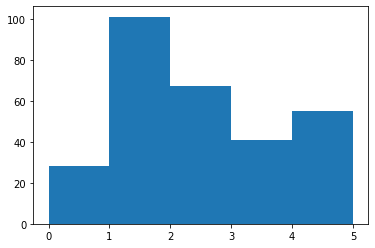

In [119]:
n, bins, patches = plt.hist(x=scream_times, bins=[0,1,2,3,4,5])

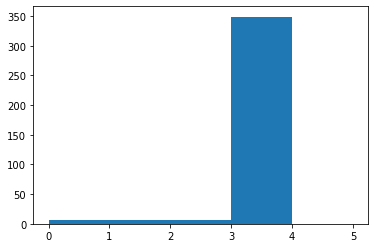

In [120]:
n, bins, patches = plt.hist(x=farMiss_times, bins=[0,1,2,3,4,5])

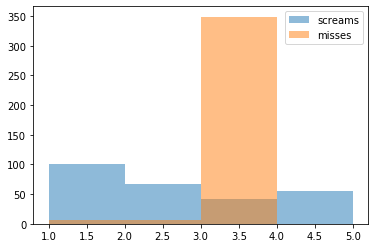

In [122]:
plt.hist(scream_times, [1,2,3,4,5], alpha=0.5, label='screams')
plt.hist(farMiss_times, [1,2,3,4,5], alpha=0.5, label='misses')
plt.legend(loc='upper right')
plt.show()

according to the above chart I think its best to set a 128 length. The whole approach is worst than "mean" in my opinion but i'll try any way.
so:
1. do a pass with "silence" splits
2. do a 128 fixing with 
    a.total len // x == 128 ==> compute x and then take max of each "group"